## Thanks for checking out the code to plot Figure 1 from Venturelli et al., 2020.

If you find this useful and hack it to make your own figures in pyGMT, I'd love to hear about it. Shoot me an email with a link when the paper is published (don't forget to cite [Wessel et al., 2019](https://agupubs.onlinelibrary.wiley.com/doi/full/10.1029/2019GC008515)). And of course let me know if you have any questions. 

*Matt Siegfried*  
*Colorado School of Mines*  
*siegfried@mines.edu*  
*16 July 2020*  

In [21]:
import xarray as xr
import pygmt
from glob import glob
import pandas as pd
import numpy as np
import os

out='venturelli2020-grl-fig1.pdf' # name of the final file

In [22]:
### SET THE DATA PATHS

# I load in an environment variable that tells me where I store 
# my data. That way if I need to change the path to my data 
# folder (say, point it to an external hard drive) I can make
# that switch trivially
datafold = os.getenv('DATAHOME')

# quick error check to make sure $DATAHOME is set
if datafold is None:
    raise OSError('environment variable $DATAHOME does not exist')

# MODIS Mosaic of Antarctica
moa = datafold + '/MODIS/MOA/moa750_2009_hp1_v01.1.tif' 

# Scripps Grounding Line
gl = datafold + '/gz/scripps/scripps_antarctica_polygons_v1.shp' 

# MEaSUREs phase-based ice velocity map
veldata = xr.open_dataset(datafold + '/velocity/measures-phase_v1/antarctic_ice_vel_phase_map_v01.nc')
# calculate velocity magnitude
vel = (veldata['VX']**2 + veldata['VY']**2)**0.5

# Siegfried & Fricker, 2018 outlines
lakefold = datafold + '/lakeoutlines/SiegfriedFricker2018/data_archive/active_lake_outlines/xy'

# Siple Coast drill sites, in GitHub directory
oldsites = 'drill_sites.txt'

# Old MOA shapes that are good enough for continent-scale insets:
moa_coast = datafold + '/gz/moa/moa_2009_coastline_v01.1.gmt'
moa_gl = datafold + '/gz/moa/moa_2009_groundingline_v01.1.gmt'

In [15]:
### SET UP BASIC FIGURE DETAILS

# We're making this a specific height
figheight=115 # in mm

# Region in PS71 for main part of the figure
ris_xl=-760000
ris_yl=-1400000
ris_xh=600000
ris_yh=-350000

# Calculate the figure width and map scale
figwidth=figheight*(ris_xh-ris_xl)/(ris_yh-ris_yl)
risratio = (ris_yh - ris_yl) / (figheight/1000)

# Make a GMT region string and projection strings in both PS71 and Lon/Lat
risreg = str(ris_xl) + '/' + str(ris_xh) + '/' + str(ris_yl) + '/' + str(ris_yh)
risproj = "x1:" + str(risratio)
risproj_ll = "s0/-90/-71/1:" + str(risratio)

# Region for Whillans Grounding Zone inset
wgz_xl=-185000
wgz_yl=-627500
wgz_xh=-145000
wgz_yh=-580000

# Make GMT region string and projection strings (only need PS71 because no graticules)
wgzreg = str(wgz_xl) + '/' + str(wgz_xh) + '/' + str(wgz_yl) + '/' + str(wgz_yh)
wgzratio = risratio/7 # 7x zoom in for the WGZ inset seems to work well
wgzmap = 'x1:' + str(wgzratio)

In [23]:
### Make color maps for MOA and ice velocity; we'll delete these in the end
pygmt.makecpt(series = '15000/17000/1', cmap = 'gray', Z = True, output = 'moa.cpt')
with pygmt.config(COLOR_FOREGROUND = '240/249/33', COLOR_BACKGROUND = '13/8/135'):
    pygmt.makecpt(series = [0,1000,1], cmap = 'plasma', output = 'vel.cpt')

/var/folders/tn/2b7yqbx51jxb820_x39chyc80000gn/T/ipykernel_24794/1091454141.py:2: SyntaxWarning: Short-form parameter (Z) is not recommended. Use long-form parameter 'continuous' instead.
  pygmt.makecpt(series = '15000/17000/1', cmap = 'gray', Z = True, output = 'moa.cpt')


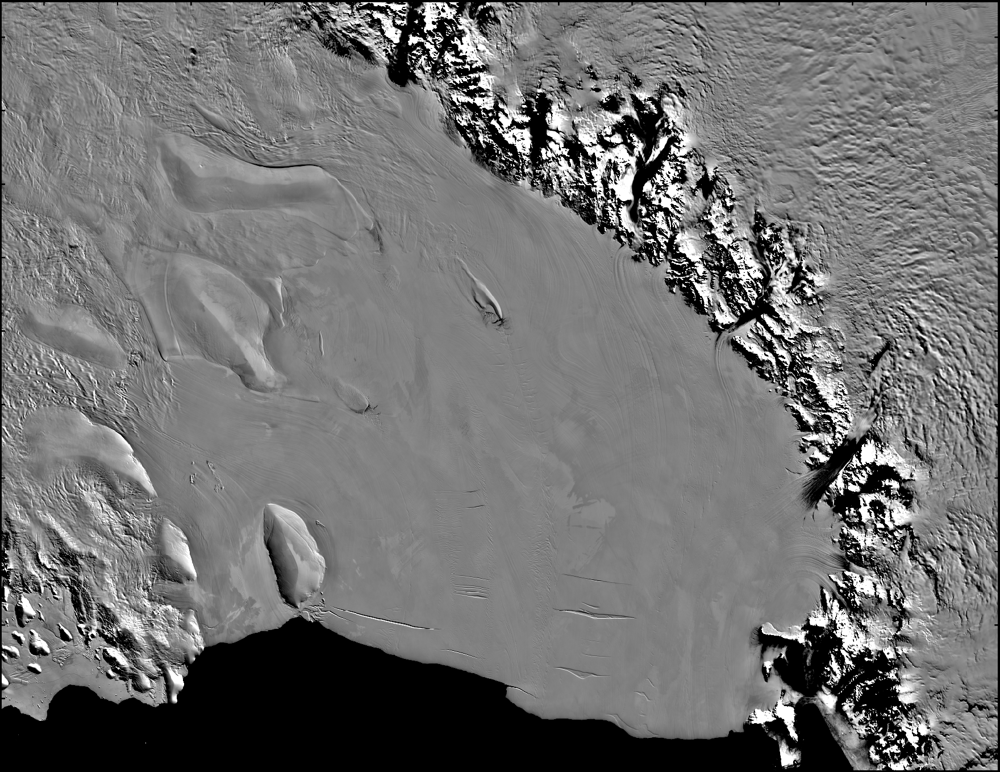

In [24]:
# Initialize figure and plot MOA as the base map with ticks every 100 km both directions
fig = pygmt.Figure()
with pygmt.config(MAP_FRAME_TYPE = 'inside'):
    fig.grdimage(region = risreg, projection = risproj, frame=["nwse", "xf100000", "yf100000"], 
                 grid = moa, cmap = 'moa.cpt')

fig.show()

/var/folders/tn/2b7yqbx51jxb820_x39chyc80000gn/T/ipykernel_24794/3658554641.py:2: SyntaxWarning: Short-form parameter (t) is not recommended. Use long-form parameter 'transparency' instead.
  fig.grdimage(grid = vel, cmap = 'vel.cpt', t = 70)#, Q = 'True')


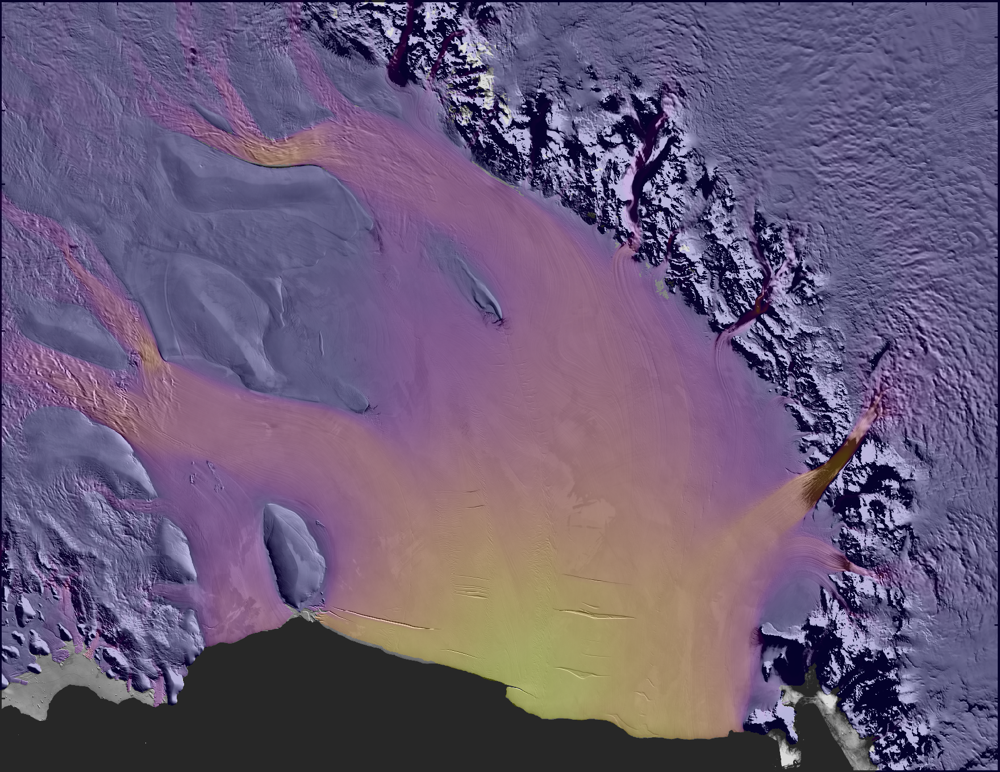

In [26]:
# Overlay ice velocity with 70% transparency
fig.grdimage(grid = vel, cmap = 'vel.cpt', t = 70)

fig.show()

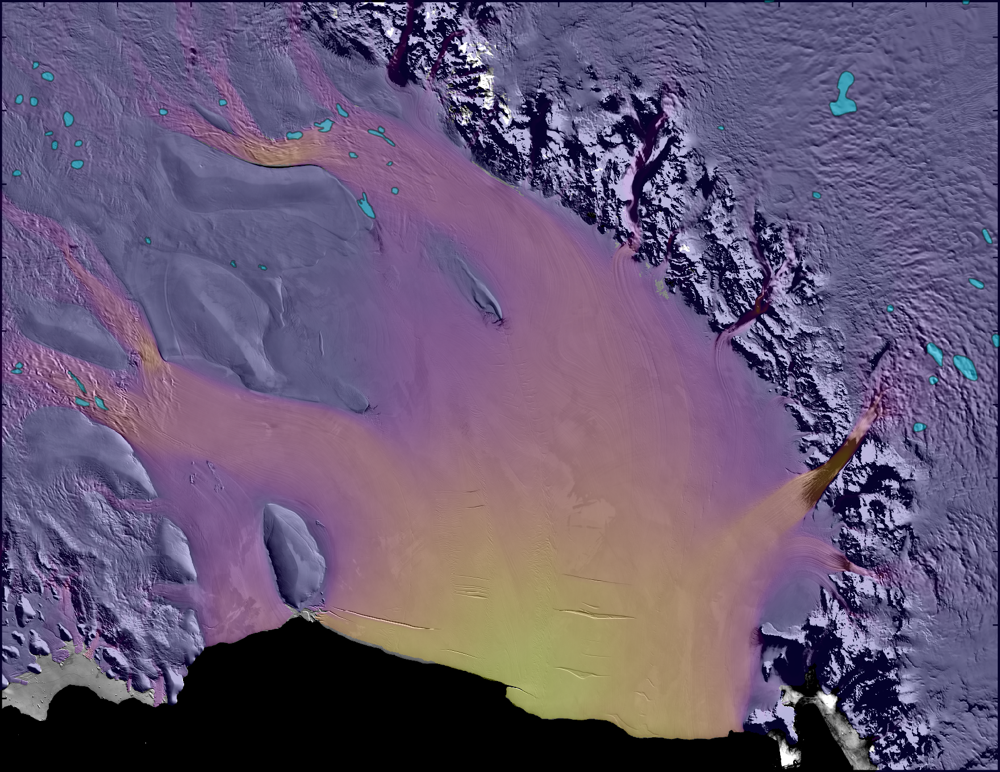

In [7]:
# Lake outlines are stored as individual files on my computer.
# Loop through all the lake files in PS71 and plot them as cyan blobs with 60% transparency.
# This will change when the lake outlines are stored as an HDF5.
for file in glob(lakefold + '/*.xy'):
    data = pd.read_csv(file, delimiter = ' |\t', header = None, names = ['x','y'], 
                       engine = 'python', usecols = [0,1])
    blocks = np.split(data, np.where(np.isnan(data.x))[0])
    for i in np.arange(0,len(blocks)):
        fig.plot(x = blocks[i]['x'][~np.isnan(blocks[i]['x'])], 
                 y = blocks[i]['y'][~np.isnan(blocks[i]['y'])], 
                 pen = "0.5p,black",
                 color = 'cyan',
                 t = 60)

fig.show()

basemap [WARNING]: For a UTM or TM projection, your region -760000/600000/-1400000/-350000 is too large to be in degrees and thus assumed to be in meters


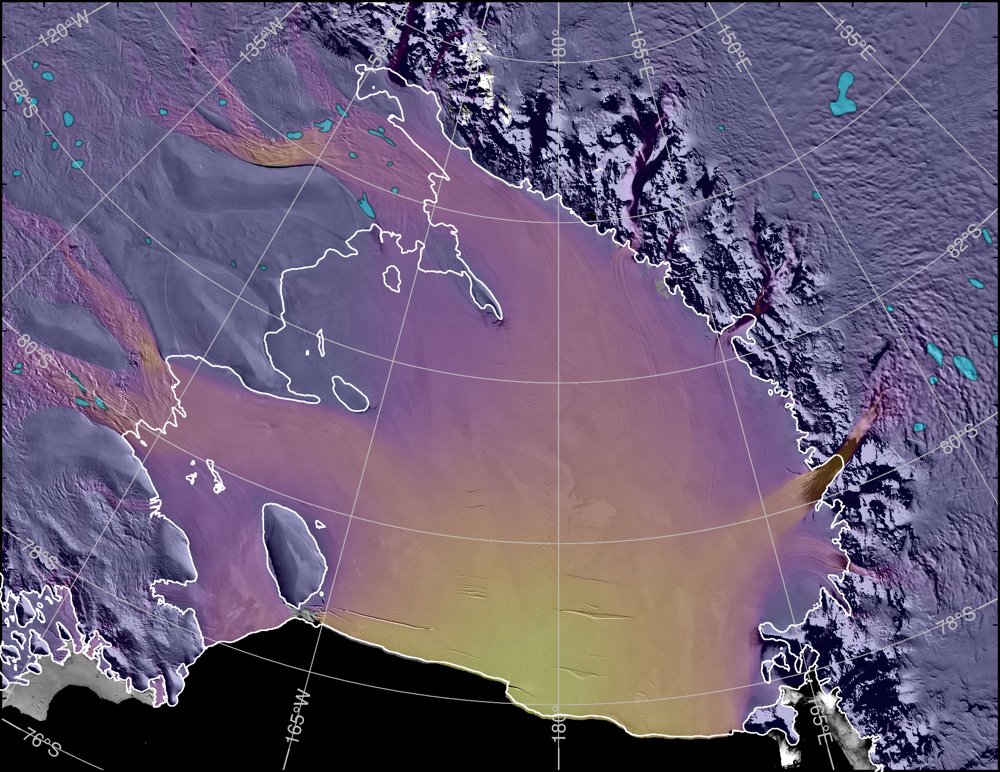

In [8]:
# Plot graticules overtop, at 2d latitude and 15d longitude
with pygmt.config(MAP_ANNOT_OFFSET_PRIMARY = '-2p', MAP_FRAME_TYPE = 'inside',
                  MAP_ANNOT_OBLIQUE = 0, FONT_ANNOT_PRIMARY = '8p,grey',
                  MAP_GRID_PEN_PRIMARY = 'grey', MAP_TICK_LENGTH_PRIMARY = '-10p',
                  MAP_TICK_PEN_PRIMARY = 'thinner,grey', FORMAT_GEO_MAP = 'dddF',
                  MAP_POLAR_CAP = '90/90'):
    fig.basemap(projection = risproj_ll, region = risreg,
                frame = ["NSWE", "xa15g15", "ya2g2"])
    
# Plot the grounding line in white
fig.plot(data = gl, region = risreg, projection = risproj, pen = '0.5p,white')

fig.show()

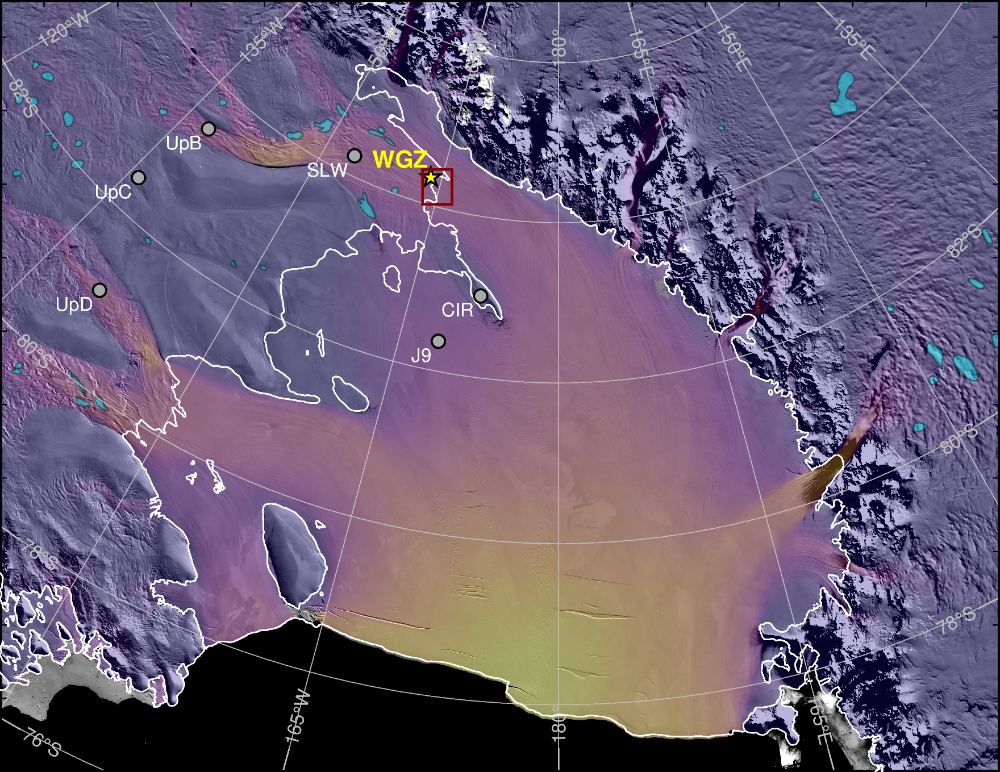

In [9]:
# Plot all the historical drill sites as dark gray circles with a label. 
# Hard code plotting the WGZ borehole as a yellow star based on the 
# coordinate in Begeman et al., 2018, JGR and label it a bit bigger
# Also draw a box around what will be shown as an inset.

drill_locs = pd.read_csv(oldsites, delimiter = ' ', comment = '#')
fig.plot(x = drill_locs['x'], y = drill_locs['y'], pen = '0.75p,black', color = 'darkgray', style = 'c0.2c')
fig.text(x = drill_locs['x'], y = drill_locs['y'], text = drill_locs['name'],
         font = '8,Helvetica,white', justify = 'TR', D = '-0.1c')

wgz = {'x': -173786.056484, 'y': -590926.324943, 'name':'WGZ'} # -163.61187, -84.33543 in PS71
fig.plot(x = wgz['x'], y = wgz['y'], style = 'a0.3c', color = 'yellow', pen = '0.75p,black')
fig.text(x = wgz['x'], y = wgz['y'], text = wgz['name'], 
         font = '10p,Helvetica-Bold,yellow', justify = 'BR', D = '-0.05c/0.15c')

fig.plot(x = [wgz_xl, wgz_xl, wgz_xh, wgz_xh, wgz_xl], y = [wgz_yl, wgz_yh, wgz_yh, wgz_yl, wgz_yl], 
         pen = '1p,darkred')

fig.show()

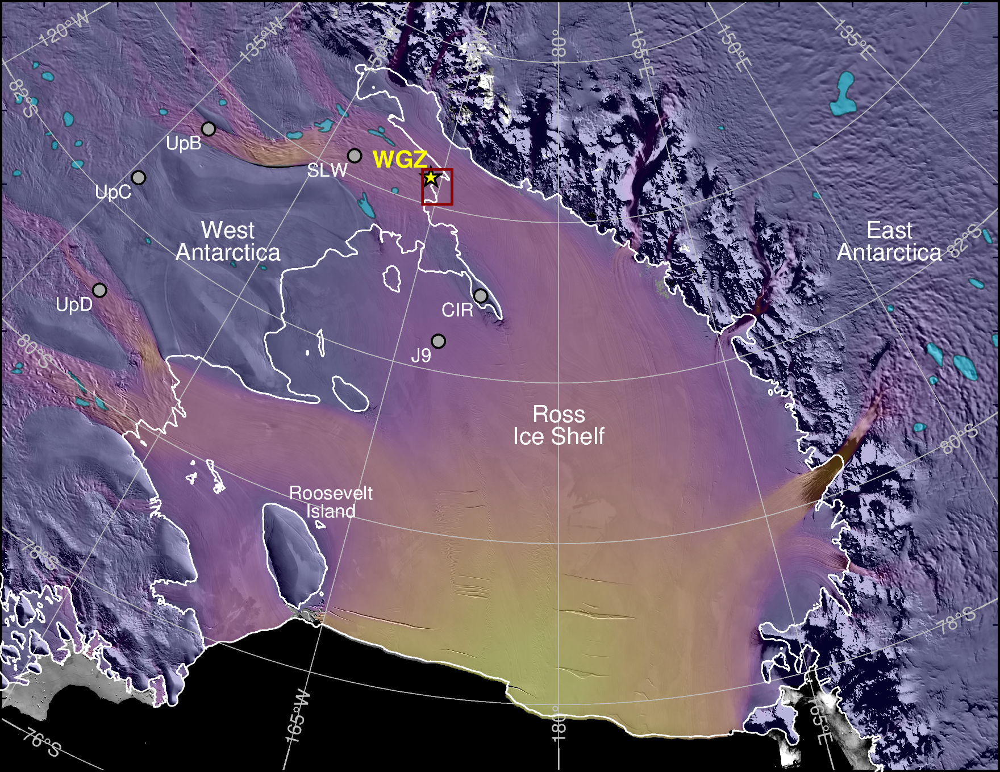

In [10]:
# Make some quick pandas data frames for labeling features of interest. 
# There will be big (10p) labels and small (8p) labels. Each size gets its 
# own data frame just to make a bit easier
big_labels = pd.DataFrame({'x': [0, 0, -450000, -450000, 450000, 450000], 
                           'y': [-900000, -930000, -650000, -680000, -650000, -680000], 
                           'label': ['Ross', 'Ice Shelf', 'West', 'Antarctica', 'East', 'Antarctica']})
small_labels = pd.DataFrame({'x': [-310000, -310000], 
                             'y': [-1010000, -1035000], 
                             'label': ['Roosevelt', 'Island']})
fig.text(x = big_labels['x'], y = big_labels['y'], text = big_labels['label'], 
         font = '10,Helvetica,white', justify = 'TC')
fig.text(x = small_labels['x'], y = small_labels['y'], text = small_labels['label'], 
         font = '8,Helvetica,white', justify = 'TC')

fig.show()

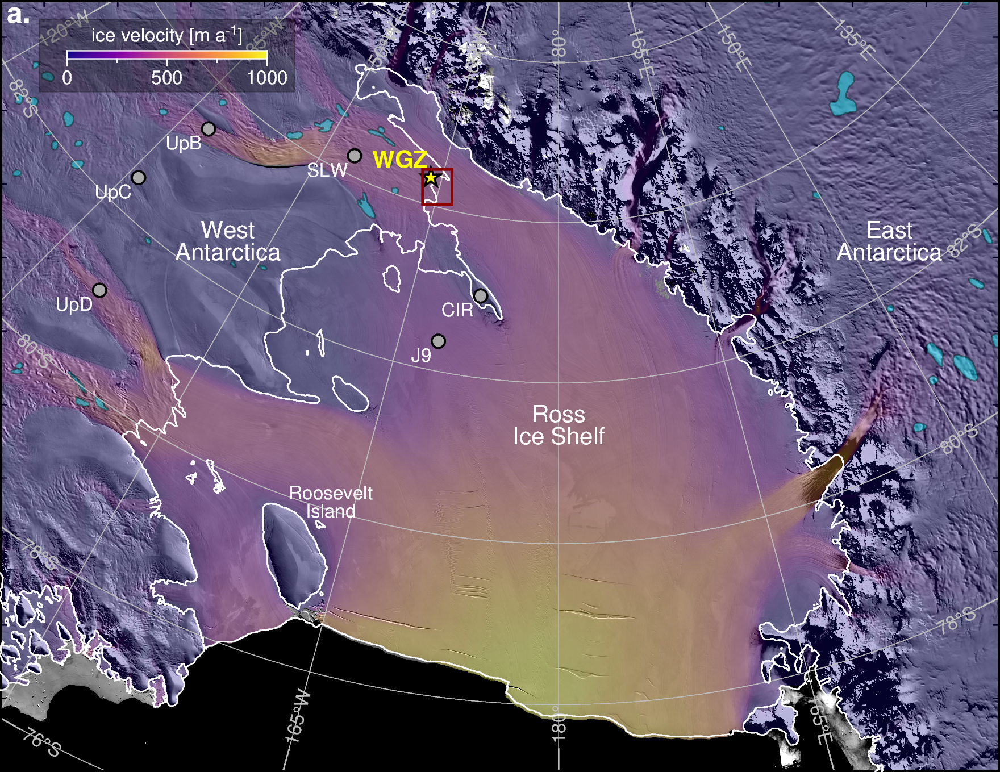

In [11]:
# Add the finishing touches -- a color bar 20% of the width of the figure
# with a 70% transparent box behind it so you can see it clearly, and put 
# a panel label in the upper lefthand corner

barwidth = figwidth/10 * 0.2 # color bar width is 20% of the map width, in cm

# Position string for feeding to the colorbar call. A bit coded, but the pyGMT 
# documents are great: https://www.pygmt.org/dev/api/index.html
pos_str = 'jTL+w' + str(barwidth) + 'c+jTL+o1c/0.75c+h+ml'

# Plot the color bar once with a transparent box, then again with no box and no transparency
with pygmt.config(FONT_ANNOT_PRIMARY = '8p,white', FONT_LABEL = '8p,white', 
                  MAP_ANNOT_OFFSET_PRIMARY = '2p', MAP_TICK_PEN_PRIMARY = '0.5p,white', 
                  MAP_TICK_LENGTH_PRIMARY = '3p', MAP_FRAME_PEN = '0.5p,white', MAP_LABEL_OFFSET = '4p'):
    fig.colorbar(cmap = 'vel.cpt', position = pos_str,
                 frame = 'xa500+l"ice velocity [m a@+-1@+]"', box = '+gblack+p0.5p,black+c3p', t = '70')
    fig.colorbar(cmap = 'vel.cpt', position = pos_str, frame = 'xa500f250+l"ice velocity [m a@+-1@+]"')

fig.text(x = ris_xl, y = ris_yh, text = 'a.', font = '12,Helvetica-Bold,white', justify = 'TL', D = '0.1c/-0.1c')

fig.show()

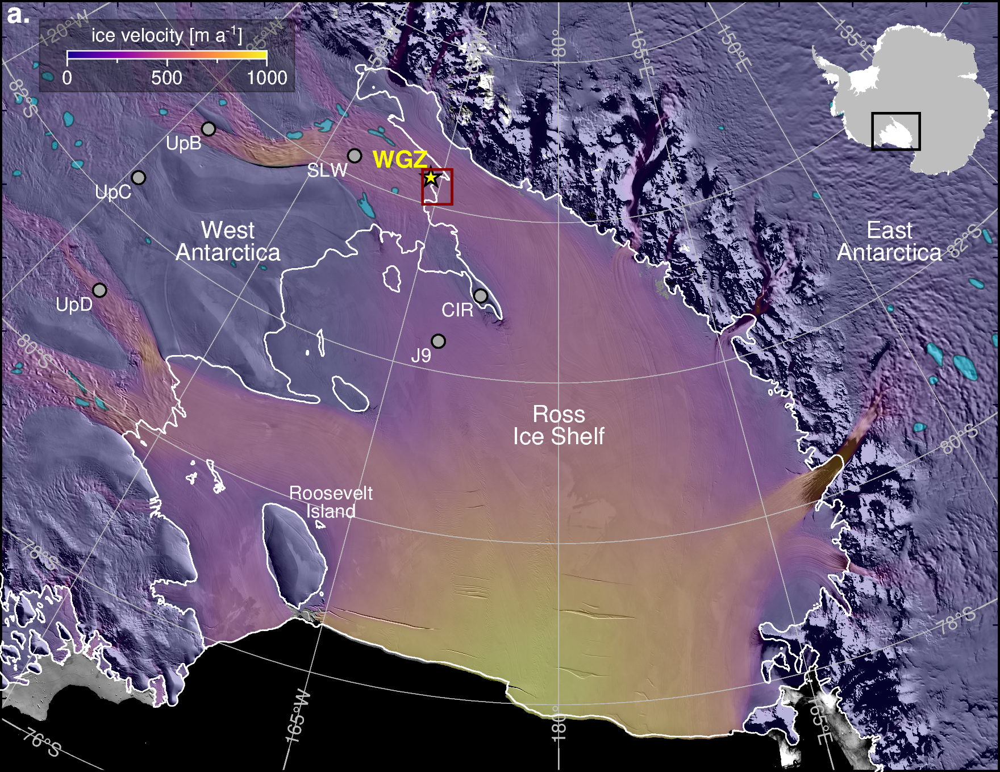

In [12]:
# Make insets of Antarctica
antwidth = 3 # width of inset in cm
antreg = '-2900000/-2900000/2900000/2900000r'
antmap = 'X' + str(antwidth) + 'c'

# generate offset string based on inset width
xoff_str = 'a' + str(figwidth/10 - antwidth) + 'c'
yoff_str = 'a' + str(figheight/10 - antwidth) + 'c'

# Plot the insets as ice shelf areas white, grounded ice gray, with a black box showing map location
fig.basemap(projection = antmap, region = antreg, frame = '+n', X = xoff_str, Y = yoff_str)
fig.plot(data = moa_coast, color = 'white', X = xoff_str, Y = yoff_str)
fig.plot(data = moa_gl, color = 'gray', X = xoff_str, Y = yoff_str)
fig.plot(x = [ris_xl, ris_xl, ris_xh, ris_xh, ris_xl], y = [ris_yl, ris_yh, ris_yh, ris_yl, ris_yl], 
         pen = '1p,black', X = xoff_str, Y = yoff_str)

fig.show()

grdimage [WARNING]: The y-coordinates and range attribute are in conflict; must rely on coordinates only


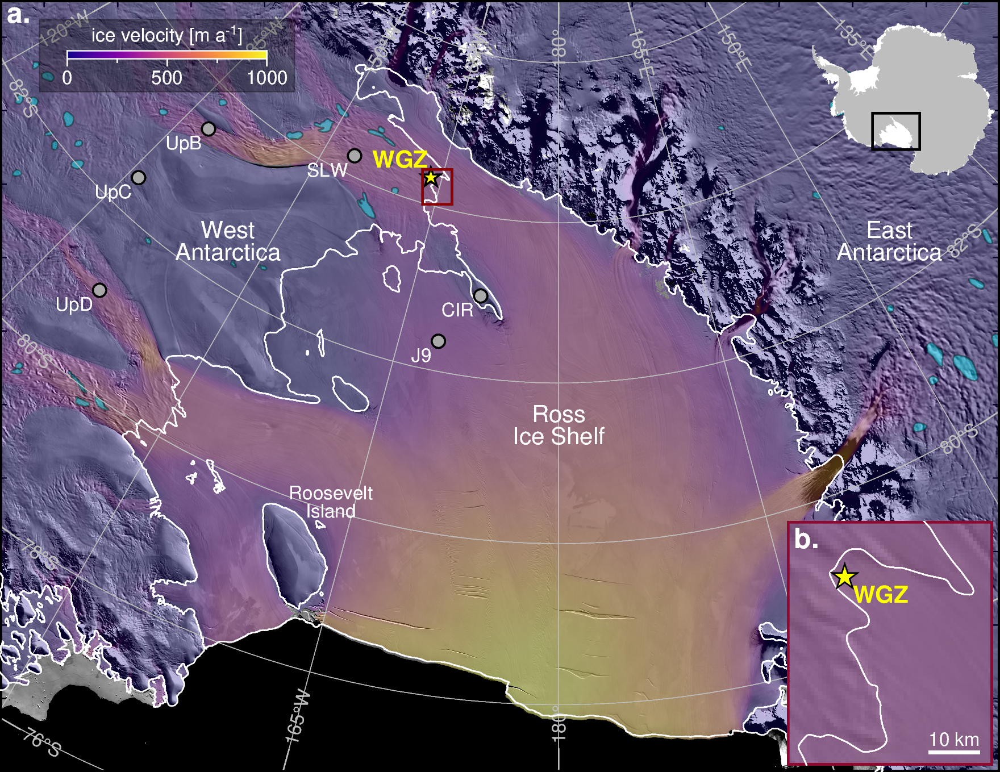

In [13]:
# Now we do it all over again for the inset panel b to show a zoom in 
# of the WGZ embayment

# Gotta do some math to get the right inset placement
fromborder = 0.1 # distance from border of figure in cm
wgzwidth = (wgz_xh - wgz_xl) / wgzratio * 100 # width of inset, in cm
xoff = figwidth/10 - (wgzwidth + fromborder) # x offset to feed GMT
yoff = fromborder # y offset to feed GMT
# generate offset strings offsets we just calculated
xoff_inset = 'a' + str(xoff) + 'c'
yoff_inset = 'a' + str(yoff) + 'c'

# Plot MOA with 70% transparent velocity overlain again and the WGZ star with label
with pygmt.config(MAP_FRAME_TYPE = 'inside', MAP_FRAME_PEN = '2p,darkred'):
    fig.grdimage(region = wgzreg, projection = wgzmap, frame = ['nswe'], 
                X = xoff_inset, Y = yoff_inset, grid = moa, cmap = 'moa.cpt')
fig.grdimage(grid = vel, cmap = 'vel.cpt', t = 70, X = xoff_inset, Y = yoff_inset)
fig.plot(data = gl, pen = '0.5p,white', X = xoff_inset, Y = yoff_inset)
fig.plot(x = wgz['x'], y = wgz['y'], style = 'a0.4c', color = 'yellow', 
         pen = '0.5p,black', X = xoff_inset, Y = yoff_inset)
fig.text(x = wgz['x'], y = wgz['y'], text = wgz['name'], font = '10,Helvetica-Bold,yellow', 
         justify = 'TL', D = '0.12c/-0.12c', X = xoff_inset, Y = yoff_inset)

# draw scale bar for the inset
wid = 10000 # scale bar length, in m
xoff = 2500 # x offset from corner
yoff = 2500 # y offset from corner

# calculate x offsets from edge of map
xleft = xoff + wid
xmid = xoff + wid/2
xright = xoff

# plot a line of length wid with a label saying the length of the scale bar
fig.plot(x = [wgz_xh - xleft, wgz_xh - xright], y = [wgz_yl + yoff, wgz_yl + yoff], 
         pen = '1.5p,white', X = xoff_inset, Y = yoff_inset)
fig.text(x = wgz_xh - xmid, y = wgz_yl + yoff, text = '{:3.0f}'.format(wid/1000) + ' km', 
         font = '8p,Helvetica,white', justify = 'BC', D = '0/0.1c', X = xoff_inset, Y = yoff_inset)

# put a subpanel label
fig.text(x = wgz_xl, y = wgz_yh, text = 'b.', font = '12,Helvetica-Bold,white', 
         justify = 'TL', D = '0.1c/-0.1c', X = xoff_inset, Y = yoff_inset)

fig.show()

In [14]:
# We're all done. Save the figure and delete the files we made.
fig.savefig(out)

del_files = ['moa.cpt','vel.cpt']
for n in del_files:
    os.remove(n)